In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [171]:
from summitutils import training, datagen, dataset
from summitutils.convert_csv_to_detectron import convert_csv_to_json

In [172]:
import pandas as pd
import glob
import matplotlib.pylab as plt
from multiprocessing import Process

# Dataset preparation

Per class: 1280 images + color + real backgrounds

In [153]:
N_images = 1280
low_frac = 0.20 #0.05 before
high_frac = 0.60
save_loc_name = 'logo_detector_realbkg_large_expanded'

logo_file_list = ['RHLOGO.jpg',
                  'ANACONDALOGO.jpg',
                  'CLOUDERALOGO.jpg',
                  'SASLOGO.png']
name_list = [name.split('.')[0].replace('LOGO', '').lower() for name in logo_file_list]

In [154]:
print(name_list)

['rh', 'anaconda', 'cloudera', 'sas']


In [155]:
#Parallelize this
for idx in range(len(logo_file_list)):
    logo_file = logo_file_list[idx]
    name = name_list[idx]
    
    print(f"Generating logos for {name}")
    
    for dataset in ['train', 'test']:
        img_list, bbox_list, csv_fields = datagen.generate_augmented_dataset(N_images, 
                                                                             low_frac=low_frac,
                                                                             high_frac=high_frac,
                                                                             logo_file=logo_file,
                                                                             N_tfms_to_apply=1,
                                                                             save_loc=f'{save_loc_name}/{name}/{dataset}',
                                                                             logo_name=name,
                                                                             generate=False,
                                                                             bkg_loc='bkg_img')

Generating logos for rh
Generating logos for anaconda
Generating logos for cloudera
Generating logos for sas


# Dataset combiner

In [160]:
dataset_name = 'logo_detector_realbkg_large_expanded'

In [161]:
dataset.combine_datasets(dataset_name)

In [162]:
#convert csv to json - move to notebook
for name in name_list + ['combined']:
    for ds in ['train', 'test']:
        if name != 'combined':
            convert_csv_to_json(f'{dataset_name}/{name}/{ds}/{name}.csv', f'{dataset_name}/{name}/{ds}/data.json')
        else:
            convert_csv_to_json(f'{dataset_name}/{name}/{ds}/labels.csv', f'{dataset_name}/{name}/{ds}/data.json')

# Training

In [163]:
dataset_name = 'logo_detector_realbkg_large_expanded/combined'

In [164]:
training.unregister()

In [165]:
#get labels
labels = list(pd.read_csv(f'{dataset_name}/train/labels.csv')['class'].unique())
print(labels)

['sas', 'rh', 'anaconda', 'cloudera']


In [166]:
#register datasets
training.register(dataset_name, labels, ['train', 'test'])
logo_train_metadata = training.get_metadata(f'{dataset_name}_train')

In [167]:
logo_train_dict = training.get_dicts(dataset_name + '/train')

{'image_id': 4115, 'file_name': 'logo_detector_realbkg_large_expanded/combined/train/sas_ewqydg.png', 'height': 512, 'width': 512, 'annotations': [{'bbox': [124, 166, 289, 331], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'category_id': 0}]}


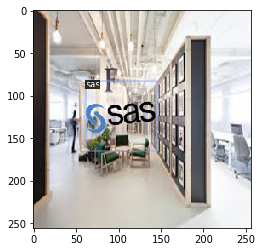

In [176]:
#plot data
training.sample_plot(logo_train_dict, logo_train_metadata, '.')

In [177]:
training.DatasetCatalog.list()

['logo_detector_realbkg_large_expanded/combined_train',
 'logo_detector_realbkg_large_expanded/combined_test']

In [178]:
N_classes = 4
trainer, cfg = training.prepare_for_training(10000, 
                                             f'{dataset_name}_output', 
                                             f'{dataset_name}_train', 
                                             N_classes,
                                             gpu_avail=True,
                                             start_training=True,
                                             model_type="COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")

[03/30 14:05:13 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[03/30 14:05:13 d2.data.build]: Removed 0 images with no usable annotations. 5120 images left.
[03/30 14:05:14 d2.data.common]: Serializing 5120 elements to byte tensors and concatenating them all ...
[03/30 14:05:14 d2.data.common]: Serialized dataset takes 1.24 MiB
[03/30 14:05:14 d2.data.detection_utils]: TransformGens used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[03/30 14:05:14 d2.data.build]: Using training sampler TrainingSampler


'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (5, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (5,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (16, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (16,) in the model! Skipped.


[03/30 14:05:14 d2.engine.train_loop]: Starting training from iteration 0
[03/30 14:05:20 d2.utils.events]:  eta: 0:45:12  iter: 19  total_loss: 1.739  loss_cls: 1.477  loss_box_reg: 0.205  loss_rpn_cls: 0.046  loss_rpn_loc: 0.007  time: 0.2708  data_time: 0.0206  lr: 0.000010  max_mem: 3712M
[03/30 14:05:25 d2.utils.events]:  eta: 0:45:29  iter: 39  total_loss: 1.536  loss_cls: 1.294  loss_box_reg: 0.178  loss_rpn_cls: 0.041  loss_rpn_loc: 0.008  time: 0.2738  data_time: 0.0050  lr: 0.000020  max_mem: 3712M
[03/30 14:05:31 d2.utils.events]:  eta: 0:45:00  iter: 59  total_loss: 1.230  loss_cls: 0.930  loss_box_reg: 0.237  loss_rpn_cls: 0.045  loss_rpn_loc: 0.005  time: 0.2736  data_time: 0.0053  lr: 0.000030  max_mem: 3712M
[03/30 14:05:36 d2.utils.events]:  eta: 0:44:49  iter: 79  total_loss: 0.866  loss_cls: 0.597  loss_box_reg: 0.258  loss_rpn_cls: 0.042  loss_rpn_loc: 0.005  time: 0.2725  data_time: 0.0046  lr: 0.000040  max_mem: 3712M
[03/30 14:05:41 d2.utils.events]:  eta: 0:44:1

[03/30 14:08:36 d2.utils.events]:  eta: 0:41:40  iter: 739  total_loss: 0.215  loss_cls: 0.041  loss_box_reg: 0.176  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2709  data_time: 0.0038  lr: 0.000250  max_mem: 3712M
[03/30 14:08:41 d2.utils.events]:  eta: 0:41:36  iter: 759  total_loss: 0.232  loss_cls: 0.037  loss_box_reg: 0.185  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2709  data_time: 0.0042  lr: 0.000250  max_mem: 3712M
[03/30 14:08:46 d2.utils.events]:  eta: 0:41:31  iter: 779  total_loss: 0.220  loss_cls: 0.033  loss_box_reg: 0.185  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2708  data_time: 0.0039  lr: 0.000250  max_mem: 3712M
[03/30 14:08:52 d2.utils.events]:  eta: 0:41:26  iter: 799  total_loss: 0.222  loss_cls: 0.040  loss_box_reg: 0.175  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2710  data_time: 0.0046  lr: 0.000250  max_mem: 3712M
[03/30 14:08:58 d2.utils.events]:  eta: 0:41:21  iter: 819  total_loss: 0.204  loss_cls: 0.036  loss_box_reg: 0.163 

[03/30 14:11:51 d2.utils.events]:  eta: 0:38:18  iter: 1459  total_loss: 0.142  loss_cls: 0.034  loss_box_reg: 0.111  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2704  data_time: 0.0046  lr: 0.000247  max_mem: 3712M
[03/30 14:11:57 d2.utils.events]:  eta: 0:38:14  iter: 1479  total_loss: 0.131  loss_cls: 0.029  loss_box_reg: 0.105  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2705  data_time: 0.0037  lr: 0.000247  max_mem: 3712M
[03/30 14:12:02 d2.utils.events]:  eta: 0:38:07  iter: 1499  total_loss: 0.133  loss_cls: 0.025  loss_box_reg: 0.095  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2704  data_time: 0.0039  lr: 0.000247  max_mem: 3712M
[03/30 14:12:08 d2.utils.events]:  eta: 0:38:03  iter: 1519  total_loss: 0.141  loss_cls: 0.029  loss_box_reg: 0.117  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2704  data_time: 0.0038  lr: 0.000247  max_mem: 3712M
[03/30 14:12:13 d2.utils.events]:  eta: 0:37:58  iter: 1539  total_loss: 0.153  loss_cls: 0.027  loss_box_reg: 0

[03/30 14:15:04 d2.utils.events]:  eta: 0:34:41  iter: 2179  total_loss: 0.094  loss_cls: 0.022  loss_box_reg: 0.073  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2689  data_time: 0.0039  lr: 0.000245  max_mem: 3712M
[03/30 14:15:09 d2.utils.events]:  eta: 0:34:35  iter: 2199  total_loss: 0.095  loss_cls: 0.019  loss_box_reg: 0.070  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2689  data_time: 0.0040  lr: 0.000245  max_mem: 3712M
[03/30 14:15:14 d2.utils.events]:  eta: 0:34:29  iter: 2219  total_loss: 0.087  loss_cls: 0.021  loss_box_reg: 0.066  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2689  data_time: 0.0037  lr: 0.000245  max_mem: 3712M
[03/30 14:15:20 d2.utils.events]:  eta: 0:34:22  iter: 2239  total_loss: 0.091  loss_cls: 0.018  loss_box_reg: 0.071  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2687  data_time: 0.0038  lr: 0.000245  max_mem: 3712M
[03/30 14:15:25 d2.utils.events]:  eta: 0:34:17  iter: 2259  total_loss: 0.099  loss_cls: 0.021  loss_box_reg: 0

[03/30 14:18:18 d2.utils.events]:  eta: 0:31:38  iter: 2899  total_loss: 0.108  loss_cls: 0.019  loss_box_reg: 0.080  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2689  data_time: 0.0038  lr: 0.000245  max_mem: 3712M
[03/30 14:18:23 d2.utils.events]:  eta: 0:31:31  iter: 2919  total_loss: 0.105  loss_cls: 0.023  loss_box_reg: 0.079  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2688  data_time: 0.0049  lr: 0.000245  max_mem: 3712M
[03/30 14:18:29 d2.utils.events]:  eta: 0:31:25  iter: 2939  total_loss: 0.092  loss_cls: 0.017  loss_box_reg: 0.059  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2688  data_time: 0.0040  lr: 0.000245  max_mem: 3712M
[03/30 14:18:34 d2.utils.events]:  eta: 0:31:20  iter: 2959  total_loss: 0.079  loss_cls: 0.017  loss_box_reg: 0.057  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2688  data_time: 0.0037  lr: 0.000245  max_mem: 3712M
[03/30 14:18:40 d2.utils.events]:  eta: 0:31:14  iter: 2979  total_loss: 0.078  loss_cls: 0.018  loss_box_reg: 0

[03/30 14:21:30 d2.utils.events]:  eta: 0:28:23  iter: 3619  total_loss: 0.095  loss_cls: 0.022  loss_box_reg: 0.066  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2682  data_time: 0.0039  lr: 0.000243  max_mem: 3712M
[03/30 14:21:35 d2.utils.events]:  eta: 0:28:16  iter: 3639  total_loss: 0.080  loss_cls: 0.012  loss_box_reg: 0.065  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2682  data_time: 0.0033  lr: 0.000243  max_mem: 3712M
[03/30 14:21:41 d2.utils.events]:  eta: 0:28:10  iter: 3659  total_loss: 0.076  loss_cls: 0.022  loss_box_reg: 0.058  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2682  data_time: 0.0040  lr: 0.000243  max_mem: 3712M
[03/30 14:21:46 d2.utils.events]:  eta: 0:28:05  iter: 3679  total_loss: 0.070  loss_cls: 0.016  loss_box_reg: 0.050  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2682  data_time: 0.0038  lr: 0.000243  max_mem: 3712M
[03/30 14:21:52 d2.utils.events]:  eta: 0:28:01  iter: 3699  total_loss: 0.087  loss_cls: 0.018  loss_box_reg: 0

[03/30 14:24:46 d2.utils.events]:  eta: 0:25:17  iter: 4339  total_loss: 0.065  loss_cls: 0.016  loss_box_reg: 0.048  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2685  data_time: 0.0038  lr: 0.000240  max_mem: 3712M
[03/30 14:24:51 d2.utils.events]:  eta: 0:25:11  iter: 4359  total_loss: 0.072  loss_cls: 0.015  loss_box_reg: 0.056  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2685  data_time: 0.0040  lr: 0.000240  max_mem: 3712M
[03/30 14:24:57 d2.utils.events]:  eta: 0:25:08  iter: 4379  total_loss: 0.079  loss_cls: 0.019  loss_box_reg: 0.057  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2685  data_time: 0.0053  lr: 0.000240  max_mem: 3712M
[03/30 14:25:02 d2.utils.events]:  eta: 0:25:04  iter: 4399  total_loss: 0.070  loss_cls: 0.013  loss_box_reg: 0.052  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2686  data_time: 0.0034  lr: 0.000240  max_mem: 3712M
[03/30 14:25:07 d2.utils.events]:  eta: 0:24:57  iter: 4419  total_loss: 0.076  loss_cls: 0.015  loss_box_reg: 0

[03/30 14:28:05 d2.utils.events]:  eta: 0:22:18  iter: 5059  total_loss: 0.072  loss_cls: 0.017  loss_box_reg: 0.051  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2690  data_time: 0.0033  lr: 0.000238  max_mem: 3712M
[03/30 14:28:10 d2.utils.events]:  eta: 0:22:08  iter: 5079  total_loss: 0.065  loss_cls: 0.015  loss_box_reg: 0.049  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2689  data_time: 0.0033  lr: 0.000238  max_mem: 3712M
[03/30 14:28:15 d2.utils.events]:  eta: 0:22:03  iter: 5099  total_loss: 0.066  loss_cls: 0.012  loss_box_reg: 0.052  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2689  data_time: 0.0049  lr: 0.000238  max_mem: 3712M
[03/30 14:28:21 d2.utils.events]:  eta: 0:21:57  iter: 5119  total_loss: 0.073  loss_cls: 0.015  loss_box_reg: 0.053  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2689  data_time: 0.0040  lr: 0.000238  max_mem: 3712M
[03/30 14:28:26 d2.utils.events]:  eta: 0:21:52  iter: 5139  total_loss: 0.084  loss_cls: 0.019  loss_box_reg: 0

[03/30 14:31:18 d2.utils.events]:  eta: 0:18:43  iter: 5779  total_loss: 0.074  loss_cls: 0.018  loss_box_reg: 0.054  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2687  data_time: 0.0042  lr: 0.000238  max_mem: 3712M
[03/30 14:31:23 d2.utils.events]:  eta: 0:18:37  iter: 5799  total_loss: 0.071  loss_cls: 0.015  loss_box_reg: 0.059  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2687  data_time: 0.0035  lr: 0.000238  max_mem: 3712M
[03/30 14:31:29 d2.utils.events]:  eta: 0:18:32  iter: 5819  total_loss: 0.076  loss_cls: 0.011  loss_box_reg: 0.061  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2687  data_time: 0.0044  lr: 0.000238  max_mem: 3712M
[03/30 14:31:34 d2.utils.events]:  eta: 0:18:26  iter: 5839  total_loss: 0.068  loss_cls: 0.015  loss_box_reg: 0.050  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2687  data_time: 0.0035  lr: 0.000238  max_mem: 3712M
[03/30 14:31:39 d2.utils.events]:  eta: 0:18:20  iter: 5859  total_loss: 0.060  loss_cls: 0.014  loss_box_reg: 0

[03/30 14:34:30 d2.utils.events]:  eta: 0:15:27  iter: 6499  total_loss: 0.059  loss_cls: 0.014  loss_box_reg: 0.044  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0055  lr: 0.000235  max_mem: 3712M
[03/30 14:34:36 d2.utils.events]:  eta: 0:15:23  iter: 6519  total_loss: 0.060  loss_cls: 0.014  loss_box_reg: 0.045  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0049  lr: 0.000235  max_mem: 3712M
[03/30 14:34:42 d2.utils.events]:  eta: 0:15:17  iter: 6539  total_loss: 0.071  loss_cls: 0.016  loss_box_reg: 0.055  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2685  data_time: 0.0056  lr: 0.000235  max_mem: 3712M
[03/30 14:34:47 d2.utils.events]:  eta: 0:15:12  iter: 6559  total_loss: 0.064  loss_cls: 0.012  loss_box_reg: 0.049  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2685  data_time: 0.0059  lr: 0.000235  max_mem: 3712M
[03/30 14:34:53 d2.utils.events]:  eta: 0:15:08  iter: 6579  total_loss: 0.069  loss_cls: 0.016  loss_box_reg: 0

[03/30 14:37:44 d2.utils.events]:  eta: 0:12:18  iter: 7219  total_loss: 0.068  loss_cls: 0.015  loss_box_reg: 0.045  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2683  data_time: 0.0036  lr: 0.000233  max_mem: 3712M
[03/30 14:37:50 d2.utils.events]:  eta: 0:12:15  iter: 7239  total_loss: 0.067  loss_cls: 0.011  loss_box_reg: 0.053  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0047  lr: 0.000233  max_mem: 3712M
[03/30 14:37:55 d2.utils.events]:  eta: 0:12:10  iter: 7259  total_loss: 0.074  loss_cls: 0.013  loss_box_reg: 0.063  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0035  lr: 0.000233  max_mem: 3712M
[03/30 14:38:01 d2.utils.events]:  eta: 0:12:05  iter: 7279  total_loss: 0.080  loss_cls: 0.015  loss_box_reg: 0.057  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0039  lr: 0.000233  max_mem: 3712M
[03/30 14:38:06 d2.utils.events]:  eta: 0:11:59  iter: 7299  total_loss: 0.071  loss_cls: 0.015  loss_box_reg: 0

[03/30 14:40:59 d2.utils.events]:  eta: 0:09:11  iter: 7939  total_loss: 0.054  loss_cls: 0.010  loss_box_reg: 0.042  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0040  lr: 0.000233  max_mem: 3712M
[03/30 14:41:05 d2.utils.events]:  eta: 0:09:06  iter: 7959  total_loss: 0.062  loss_cls: 0.014  loss_box_reg: 0.043  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0037  lr: 0.000233  max_mem: 3712M
[03/30 14:41:10 d2.utils.events]:  eta: 0:09:00  iter: 7979  total_loss: 0.067  loss_cls: 0.014  loss_box_reg: 0.045  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0031  lr: 0.000233  max_mem: 3712M
[03/30 14:41:16 d2.utils.events]:  eta: 0:08:55  iter: 7999  total_loss: 0.067  loss_cls: 0.019  loss_box_reg: 0.050  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0063  lr: 0.000233  max_mem: 3712M
[03/30 14:41:21 d2.utils.events]:  eta: 0:08:51  iter: 8019  total_loss: 0.063  loss_cls: 0.011  loss_box_reg: 0

[03/30 14:44:14 d2.utils.events]:  eta: 0:05:57  iter: 8659  total_loss: 0.068  loss_cls: 0.013  loss_box_reg: 0.050  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2685  data_time: 0.0033  lr: 0.000231  max_mem: 3712M
[03/30 14:44:19 d2.utils.events]:  eta: 0:05:52  iter: 8679  total_loss: 0.062  loss_cls: 0.010  loss_box_reg: 0.050  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0036  lr: 0.000231  max_mem: 3712M
[03/30 14:44:25 d2.utils.events]:  eta: 0:05:46  iter: 8699  total_loss: 0.056  loss_cls: 0.010  loss_box_reg: 0.043  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0037  lr: 0.000231  max_mem: 3712M
[03/30 14:44:30 d2.utils.events]:  eta: 0:05:41  iter: 8719  total_loss: 0.058  loss_cls: 0.011  loss_box_reg: 0.044  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2684  data_time: 0.0039  lr: 0.000231  max_mem: 3712M
[03/30 14:44:35 d2.utils.events]:  eta: 0:05:35  iter: 8739  total_loss: 0.059  loss_cls: 0.011  loss_box_reg: 0

[03/30 14:47:25 d2.utils.events]:  eta: 0:02:44  iter: 9379  total_loss: 0.058  loss_cls: 0.012  loss_box_reg: 0.044  loss_rpn_cls: 0.000  loss_rpn_loc: 0.000  time: 0.2681  data_time: 0.0036  lr: 0.000228  max_mem: 3712M
[03/30 14:47:31 d2.utils.events]:  eta: 0:02:38  iter: 9399  total_loss: 0.050  loss_cls: 0.012  loss_box_reg: 0.039  loss_rpn_cls: 0.000  loss_rpn_loc: 0.000  time: 0.2681  data_time: 0.0032  lr: 0.000228  max_mem: 3712M
[03/30 14:47:36 d2.utils.events]:  eta: 0:02:33  iter: 9419  total_loss: 0.056  loss_cls: 0.013  loss_box_reg: 0.040  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2681  data_time: 0.0034  lr: 0.000228  max_mem: 3712M
[03/30 14:47:41 d2.utils.events]:  eta: 0:02:28  iter: 9439  total_loss: 0.057  loss_cls: 0.011  loss_box_reg: 0.045  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2681  data_time: 0.0034  lr: 0.000228  max_mem: 3712M
[03/30 14:47:46 d2.utils.events]:  eta: 0:02:22  iter: 9459  total_loss: 0.056  loss_cls: 0.011  loss_box_reg: 0

# Inference

In [179]:
dataset_name = 'logo_detector_realbkg_large_expanded/combined'

In [180]:
training.unregister()

In [181]:
#get labels
labels = list(pd.read_csv(f'{dataset_name}/train/labels.csv')['class'].unique())
print(labels)

['sas', 'rh', 'anaconda', 'cloudera']


In [182]:
#register datasets
training.register(dataset_name, labels, ['train', 'test'])
logo_train_metadata = training.get_metadata(f'{dataset_name}_train')

In [183]:
N_classes = 4
trainer, cfg = training.prepare_for_training(2000, 
                                             f'{dataset_name}_output', 
                                             f'{dataset_name}_train', 
                                             N_classes,
                                             gpu_avail=True,
                                             start_training=False,
                                             model_type="COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
predictor = training.prepare_for_inference(cfg, f'{dataset_name}_test', threshold=0.50)

[03/30 14:51:04 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[03/30 14:51:04 d2.data.build]: Removed 0 images with no usable annotations. 5120 images left.
[03/30 14:51:04 d2.data.common]: Serializing 5120 elements to byte tensors and concatenating them all ...
[03/30 14:51:04 d2.data.common]: Serialized dataset takes 1.24 MiB
[03/30 14:51:04 d2.data.detection_utils]: TransformGens used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[03/30 14:51:04 d2.data.build]: Using training sampler TrainingSampler


'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (5, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (5,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (16, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (16,) in the model! Skipped.


Reading weights from output dir: logo_detector_realbkg_large_expanded/combined_output


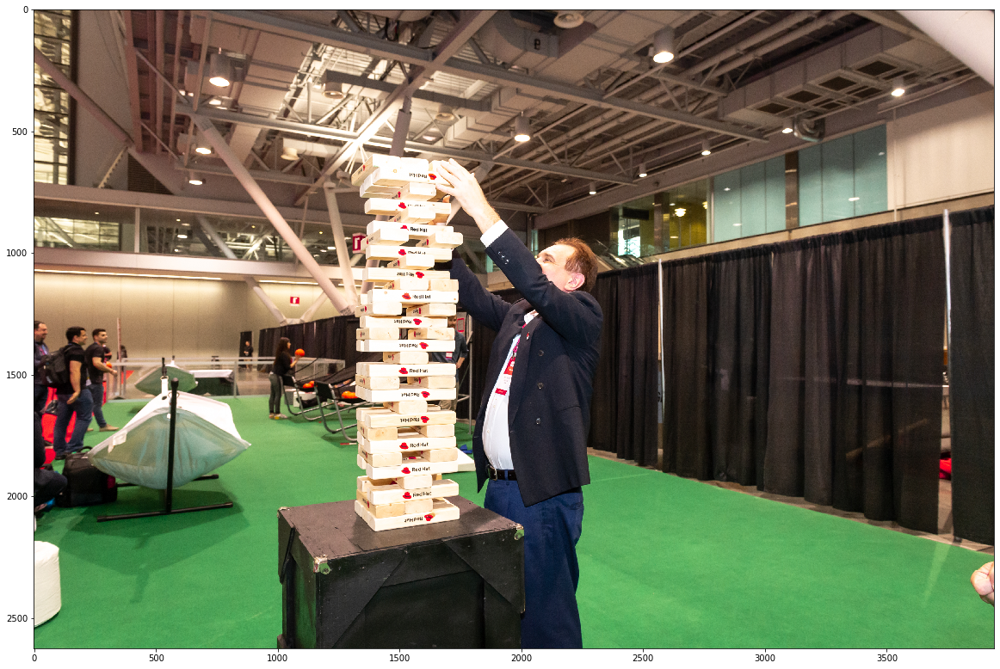

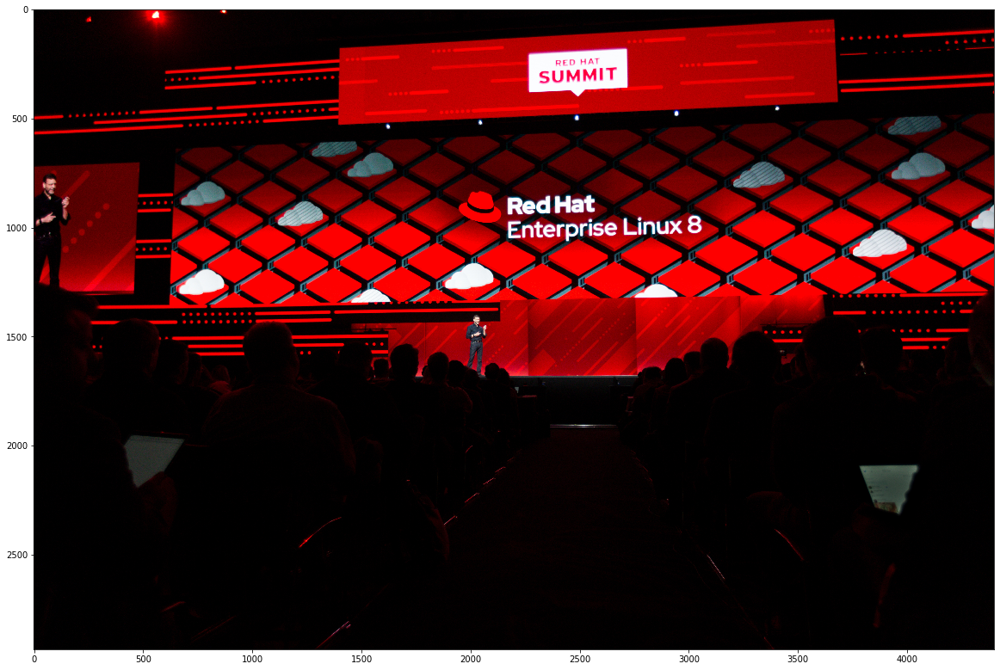

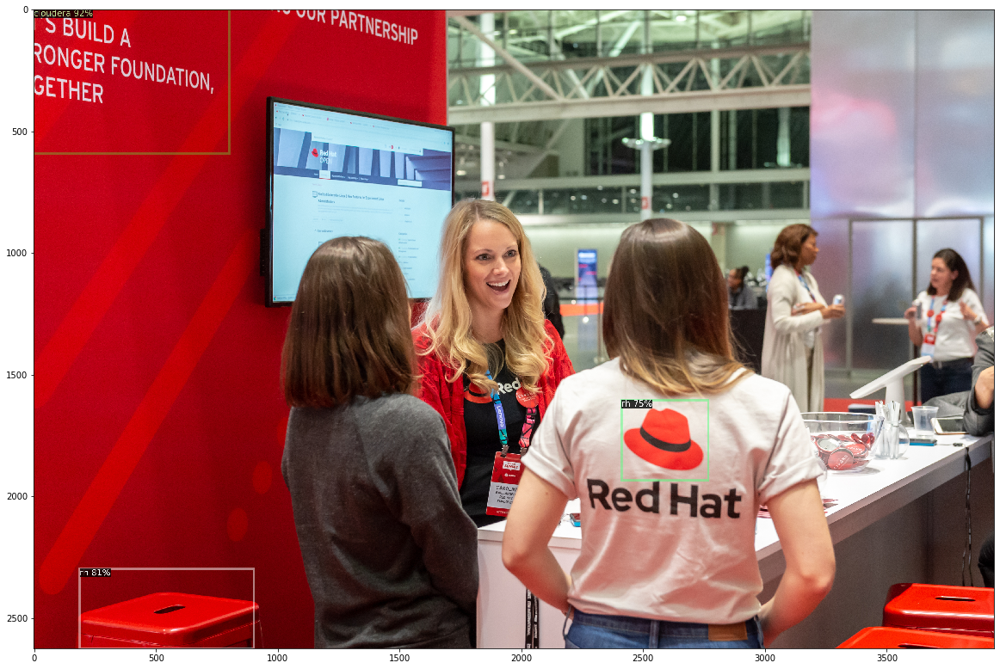

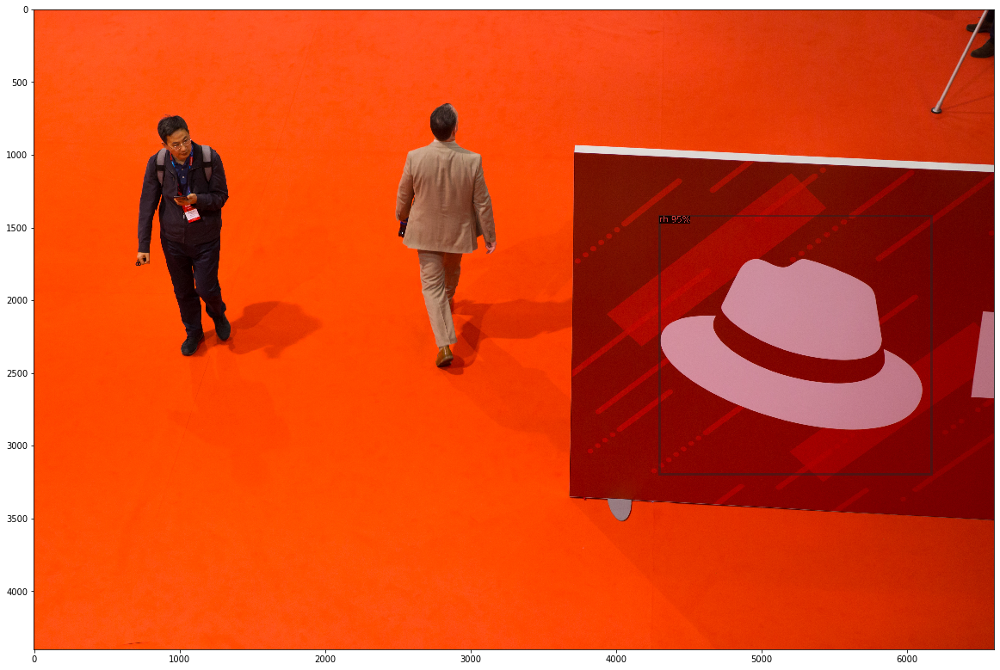

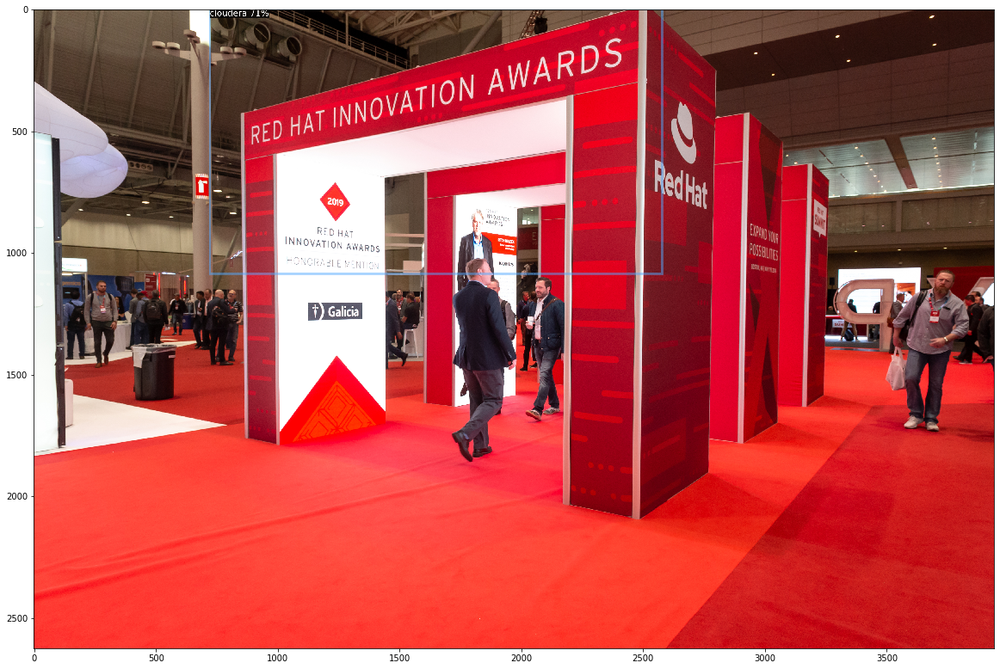

...

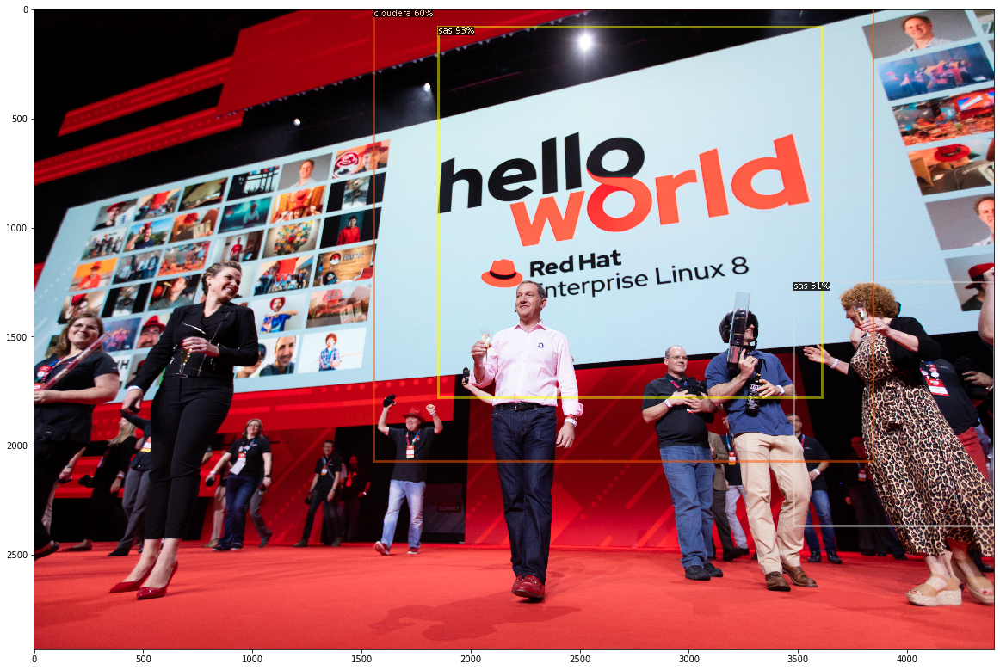

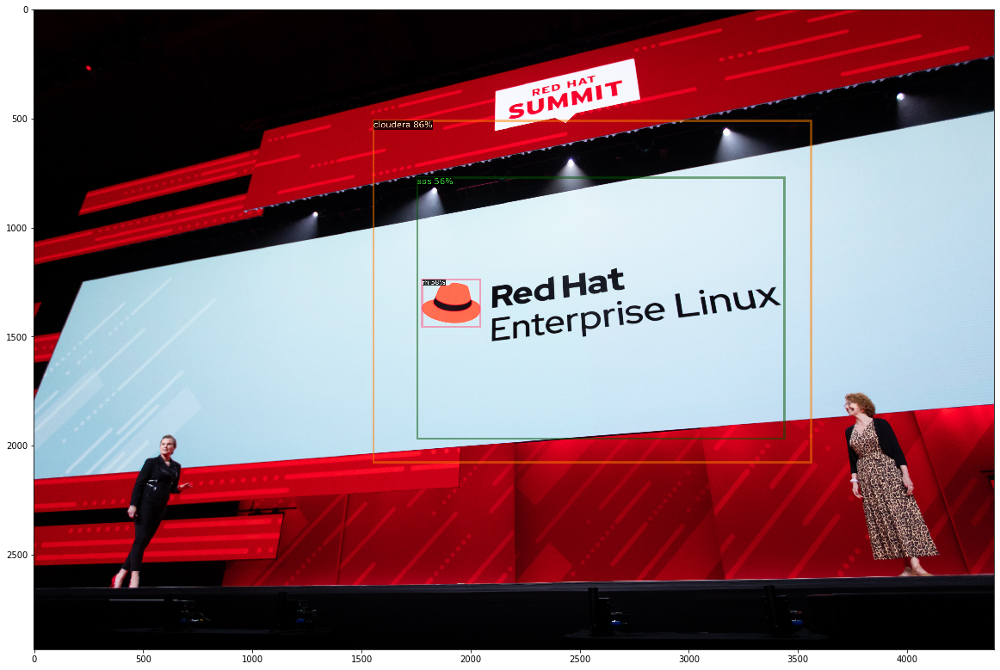

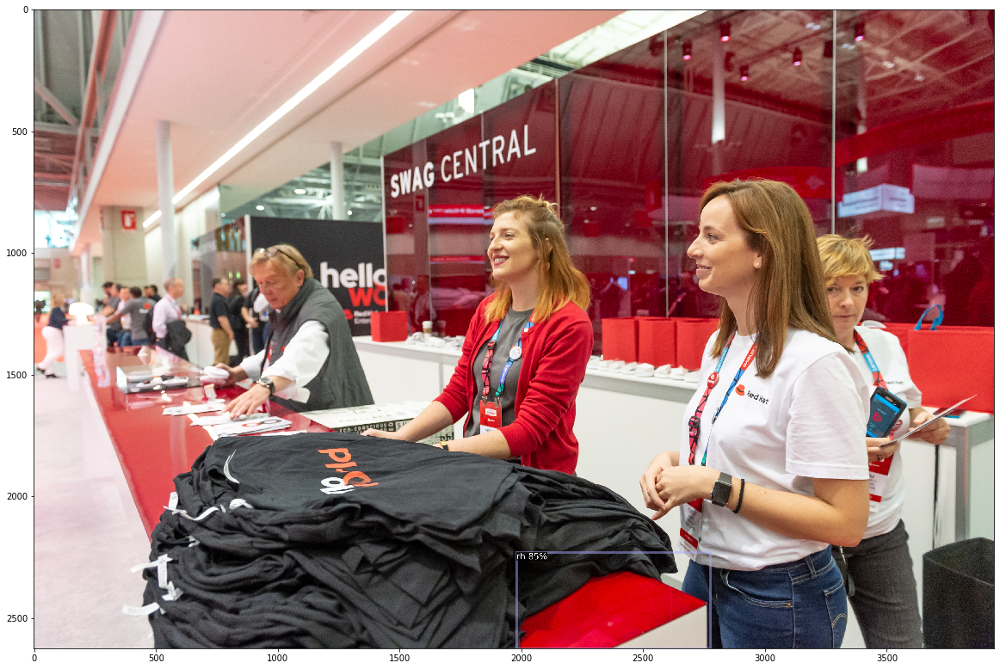

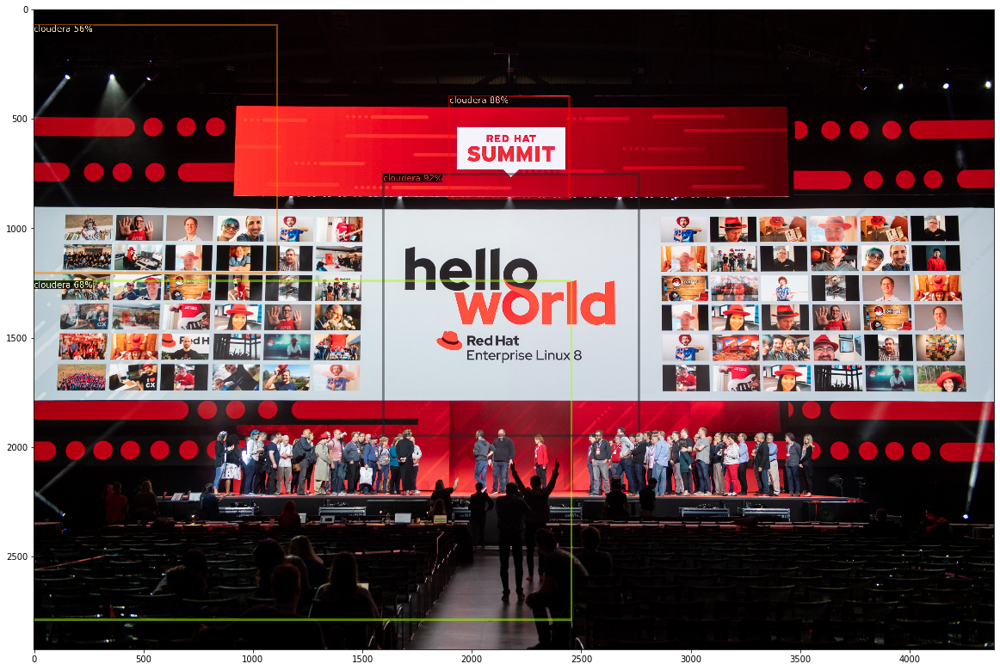

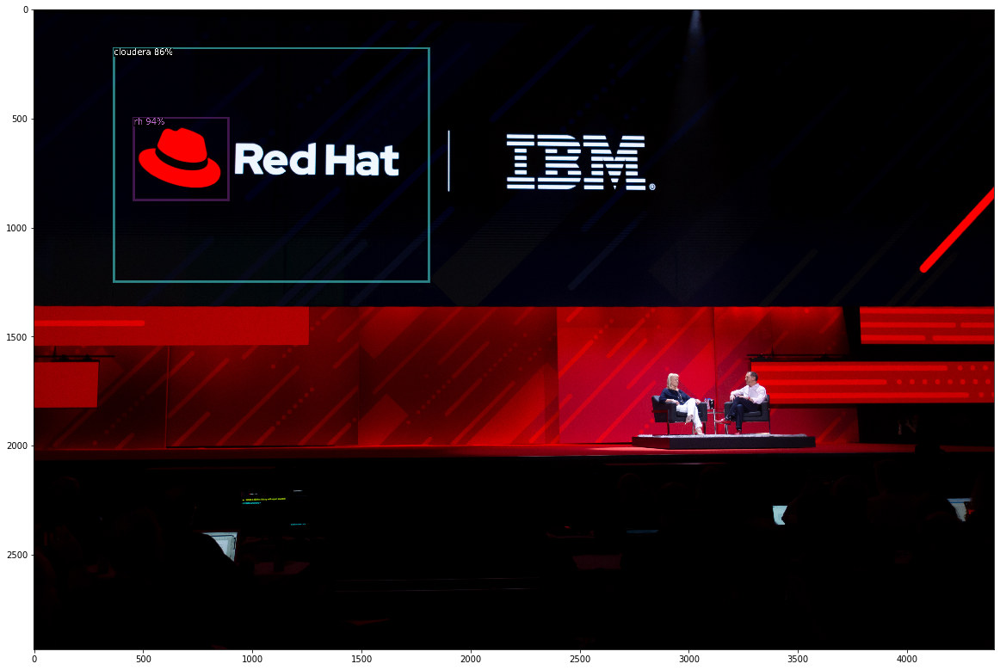

In [184]:
for img in glob.glob('rhlogo_summit_val/*'):
    plt.figure(figsize=(20,20))
    outputs = training.infer_img_v2(predictor, img, logo_train_metadata)

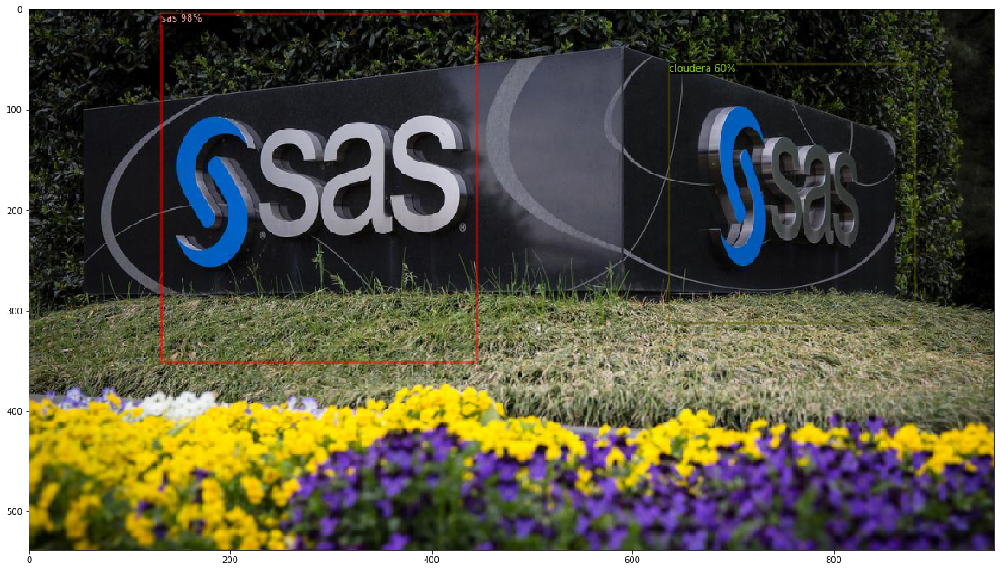

In [185]:
img = 'sasimage.jpg'
plt.figure(figsize=(20,20))
outputs = training.infer_img_v2(predictor, img, logo_train_metadata)

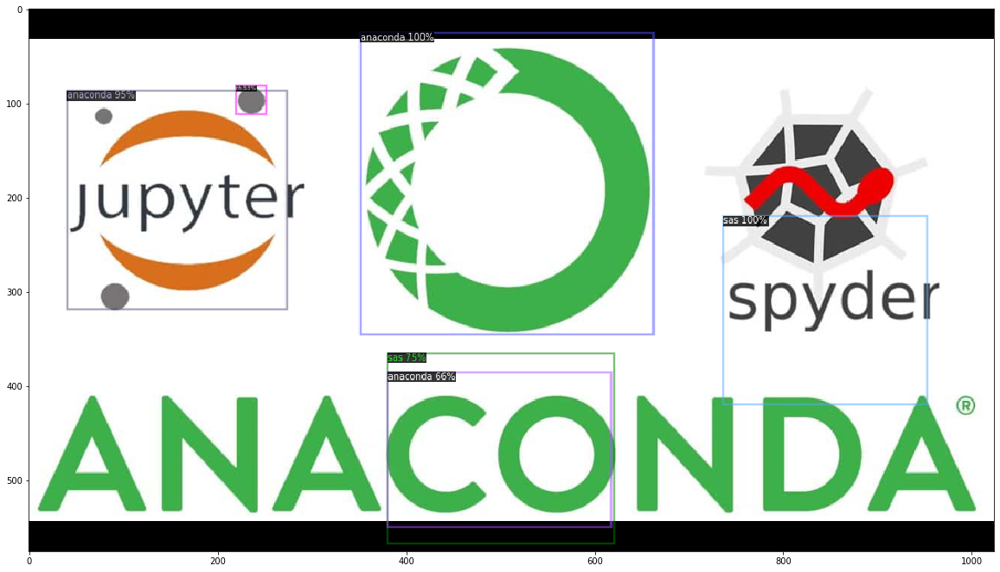

In [186]:
img = 'anacondaimage.jpg'
plt.figure(figsize=(20,20))
outputs = training.infer_img_v2(predictor, img, logo_train_metadata)

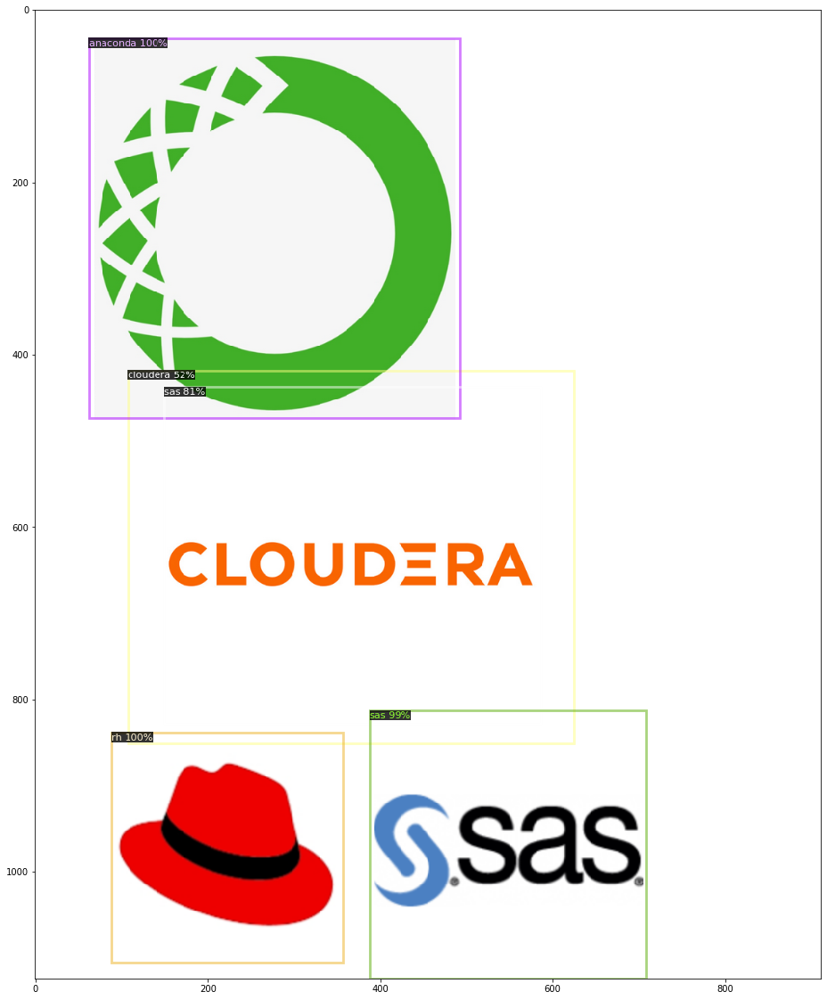

In [187]:
img = 'summitlogos.png'
plt.figure(figsize=(20,20))
outputs = training.infer_img_v2(predictor, img, logo_train_metadata)

{'instances': Instances(num_instances=2, image_height=512, image_width=512, fields=[pred_boxes: Boxes(tensor([[ 83.2453,  86.0127, 253.7462, 243.1764],
        [ 72.5000,  75.7958, 264.6370, 251.9596]], device='cuda:0')), scores: tensor([0.9556, 0.6527], device='cuda:0'), pred_classes: tensor([0, 3], device='cuda:0')])}


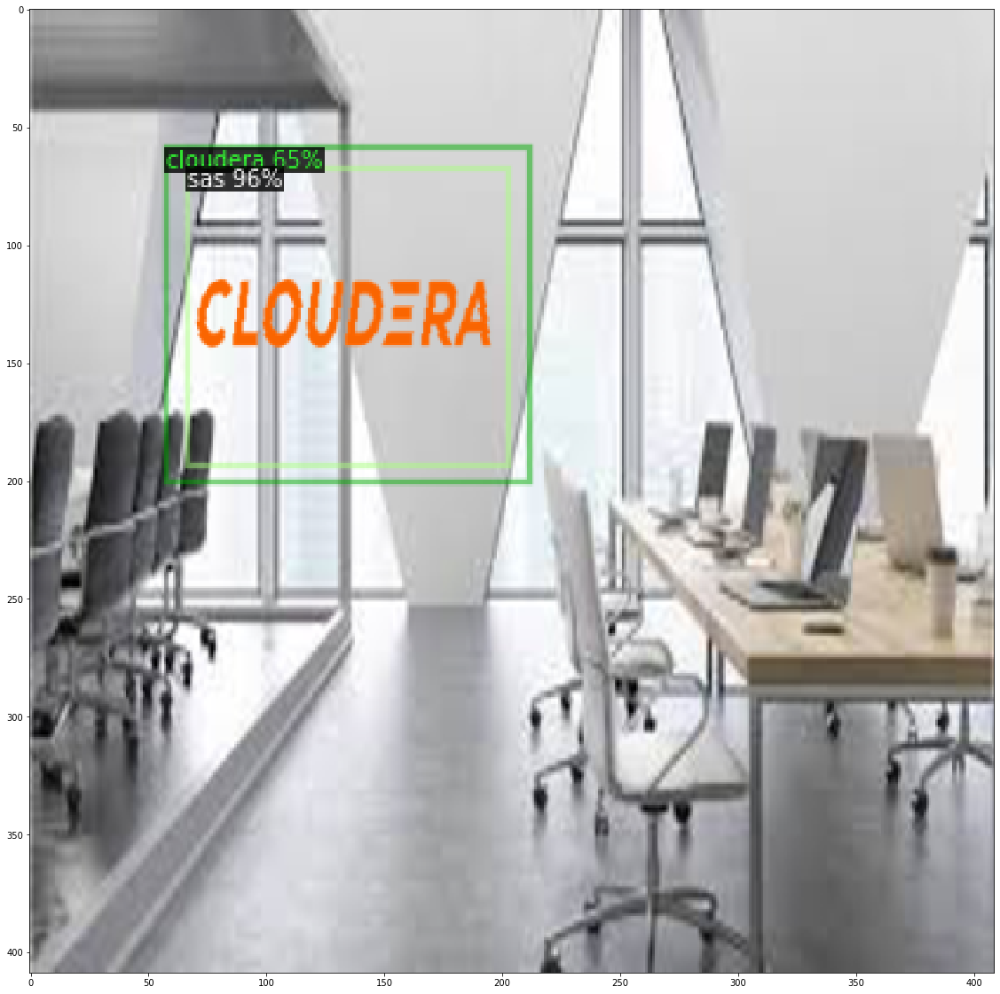

In [188]:
img = 'logo_detector_realbkg_expanded/combined/test/cloudera_ycofvk.png'
plt.figure(figsize=(20,20))
outputs = training.infer_img_v2(predictor, img, logo_train_metadata)
print(outputs)

# Evaluation Metrics

In [189]:
from summitutils import evaluation

In [190]:
print(dataset_name)

logo_detector_realbkg_large_expanded/combined


In [191]:
evaluation.evaluate(f'{dataset_name}_train', f'{dataset_name}_output', cfg, predictor.model)

WARNING [03/30 14:54:03 d2.evaluation.coco_evaluation]: json_file was not found in MetaDataCatalog for 'logo_detector_realbkg_large_expanded/combined_train'. Trying to convert it to COCO format ...
[03/30 14:54:03 d2.data.datasets.coco]: Converting dataset annotations in 'logo_detector_realbkg_large_expanded/combined_train' to COCO format ...)
[03/30 14:54:03 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[03/30 14:54:04 d2.data.datasets.coco]: Conversion finished, num images: 5120, num annotations: 5120
[03/30 14:54:04 d2.data.datasets.coco]: Caching annotations in COCO format: logo_detector_realbkg_large_expanded/combined_output/logo_detector_realbkg_large_expanded/combined_train_coco_format.json
[03/30 14:54:05 d2.data.common]: Serializing 5120 elements to byte tensors and concatenating them all ...
[03/30 14:54:05 d2.data.common]: Serialized dataset takes 1.24 MiB
[03/30 14:54:05 d2.evaluation.evaluator]: Start inference on 5120 images
[03/30 14:54:06 d2.evaluati

[03/30 14:59:54 d2.evaluation.evaluator]: Inference done 4833/5120. 0.0703 s / img. ETA=0:00:20
[03/30 14:59:59 d2.evaluation.evaluator]: Inference done 4904/5120. 0.0703 s / img. ETA=0:00:15
[03/30 15:00:04 d2.evaluation.evaluator]: Inference done 4975/5120. 0.0703 s / img. ETA=0:00:10
[03/30 15:00:09 d2.evaluation.evaluator]: Inference done 5047/5120. 0.0703 s / img. ETA=0:00:05
[03/30 15:00:14 d2.evaluation.evaluator]: Inference done 5119/5120. 0.0703 s / img. ETA=0:00:00
[03/30 15:00:14 d2.evaluation.evaluator]: Total inference time: 0:06:08.362672 (0.072016 s / img per device, on 1 devices)
[03/30 15:00:14 d2.evaluation.evaluator]: Total inference pure compute time: 0:05:59 (0.070256 s / img per device, on 1 devices)
[03/30 15:00:14 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/30 15:00:14 d2.evaluation.coco_evaluation]: Saving results to logo_detector_realbkg_large_expanded/combined_output/coco_instances_results.json
[03/30 15:00:14 d2.evaluation.coco_

OrderedDict([('bbox',
              {'AP': 98.69425602492734,
               'AP50': 100.0,
               'AP75': 100.0,
               'APs': nan,
               'APm': 98.14356435643565,
               'APl': 98.67426280053941,
               'AP-sas': 96.01954147609906,
               'AP-rh': 99.85761234230594,
               'AP-anaconda': 99.89719987623764,
               'AP-cloudera': 99.00267040506675})])

In [192]:
evaluation.evaluate(f'{dataset_name}_test', f'{dataset_name}_output', cfg, predictor.model)

WARNING [03/30 15:00:16 d2.evaluation.coco_evaluation]: json_file was not found in MetaDataCatalog for 'logo_detector_realbkg_large_expanded/combined_test'. Trying to convert it to COCO format ...
[03/30 15:00:16 d2.data.datasets.coco]: Converting dataset annotations in 'logo_detector_realbkg_large_expanded/combined_test' to COCO format ...)
[03/30 15:00:16 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[03/30 15:00:17 d2.data.datasets.coco]: Conversion finished, num images: 5120, num annotations: 5120
[03/30 15:00:18 d2.data.datasets.coco]: Caching annotations in COCO format: logo_detector_realbkg_large_expanded/combined_output/logo_detector_realbkg_large_expanded/combined_test_coco_format.json
[03/30 15:00:18 d2.data.common]: Serializing 5120 elements to byte tensors and concatenating them all ...
[03/30 15:00:18 d2.data.common]: Serialized dataset takes 1.24 MiB
[03/30 15:00:18 d2.evaluation.evaluator]: Start inference on 5120 images
[03/30 15:00:19 d2.evaluation.

[03/30 15:06:07 d2.evaluation.evaluator]: Inference done 3883/5120. 0.0880 s / img. ETA=0:01:51
[03/30 15:06:12 d2.evaluation.evaluator]: Inference done 3923/5120. 0.0884 s / img. ETA=0:01:47
[03/30 15:06:17 d2.evaluation.evaluator]: Inference done 3963/5120. 0.0887 s / img. ETA=0:01:44
[03/30 15:06:22 d2.evaluation.evaluator]: Inference done 4003/5120. 0.0891 s / img. ETA=0:01:41
[03/30 15:06:27 d2.evaluation.evaluator]: Inference done 4044/5120. 0.0894 s / img. ETA=0:01:38
[03/30 15:06:32 d2.evaluation.evaluator]: Inference done 4085/5120. 0.0898 s / img. ETA=0:01:34
[03/30 15:06:37 d2.evaluation.evaluator]: Inference done 4125/5120. 0.0901 s / img. ETA=0:01:31
[03/30 15:06:42 d2.evaluation.evaluator]: Inference done 4165/5120. 0.0904 s / img. ETA=0:01:28
[03/30 15:06:47 d2.evaluation.evaluator]: Inference done 4205/5120. 0.0908 s / img. ETA=0:01:24
[03/30 15:06:52 d2.evaluation.evaluator]: Inference done 4246/5120. 0.0911 s / img. ETA=0:01:21
[03/30 15:06:57 d2.evaluation.evaluator]

OrderedDict([('bbox',
              {'AP': 98.65257212962966,
               'AP50': 100.0,
               'AP75': 100.0,
               'APs': nan,
               'APm': 97.72277227722772,
               'APl': 98.6525103542066,
               'AP-sas': 95.77293061965116,
               'AP-rh': 99.8542051983923,
               'AP-anaconda': 99.86657973833097,
               'AP-cloudera': 99.11657296214425})])

In [193]:
# Precision-recall curves